# Predicting House Prices in King County

Given data on the prices of some 21,000 houses in King County, WA, as well as 20 other features (including square footage, number of bedrooms and bathrooms, number of floors, year built, and zipcode, to name a few), which of those features prove most useful for predicting the price of a house? With the goal of finding those most influential features, the project below has decidedly prioritized inference over raw prediction power. Where small gains in prediction accuracy could be sacrificed for greater interpretability, the exchange was readily made for a more "readable" model.

For that reason, feature engineering and shrinkage methods (namely, the Lasso), have been liberally applied; meanwhile, feature interaction terms, and the majority of the features themselves, in fact, were ignored. Stepwise feature selection was passed over, as [concerns have been raised concerning the integrity of the method](https://towardsdatascience.com/stopping-stepwise-why-stepwise-selection-is-bad-and-what-you-should-use-instead-90818b3f52df).

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import statsmodels.api as sm
import statsmodels.formula.api as smf
from sklearn.metrics import mean_squared_error, make_scorer
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.feature_selection import RFE
from sklearn.linear_model import Lasso
import scipy.stats as stats
%matplotlib inline

### Phase 1: Cleaning, exploring.

In [2]:
df = pd.read_csv('data/kc_house_data.csv')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21597 non-null  int64  
 1   date           21597 non-null  object 
 2   price          21597 non-null  float64
 3   bedrooms       21597 non-null  int64  
 4   bathrooms      21597 non-null  float64
 5   sqft_living    21597 non-null  int64  
 6   sqft_lot       21597 non-null  int64  
 7   floors         21597 non-null  float64
 8   waterfront     19221 non-null  float64
 9   view           21534 non-null  float64
 10  condition      21597 non-null  int64  
 11  grade          21597 non-null  int64  
 12  sqft_above     21597 non-null  int64  
 13  sqft_basement  21597 non-null  object 
 14  yr_built       21597 non-null  int64  
 15  yr_renovated   17755 non-null  float64
 16  zipcode        21597 non-null  int64  
 17  lat            21597 non-null  float64
 18  long  

In [3]:
# I explored each of these features using .unique() and .value_counts() to find the placeholder values.
# Here, I replace them with numerical equivalents.
df.loc[df.sqft_basement == '?'] = 0
df['sqft_basement'] = df.sqft_basement.astype('float')
df['waterfront'] = df.waterfront.fillna(0)
df['view'] = df.view.fillna(0)
df['yr_renovated'] = df.yr_renovated.fillna(0)

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21597 non-null  int64  
 1   date           21597 non-null  object 
 2   price          21597 non-null  float64
 3   bedrooms       21597 non-null  int64  
 4   bathrooms      21597 non-null  float64
 5   sqft_living    21597 non-null  int64  
 6   sqft_lot       21597 non-null  int64  
 7   floors         21597 non-null  float64
 8   waterfront     21597 non-null  float64
 9   view           21597 non-null  float64
 10  condition      21597 non-null  int64  
 11  grade          21597 non-null  int64  
 12  sqft_above     21597 non-null  int64  
 13  sqft_basement  21597 non-null  float64
 14  yr_built       21597 non-null  int64  
 15  yr_renovated   21597 non-null  float64
 16  zipcode        21597 non-null  int64  
 17  lat            21597 non-null  float64
 18  long  

<AxesSubplot:>

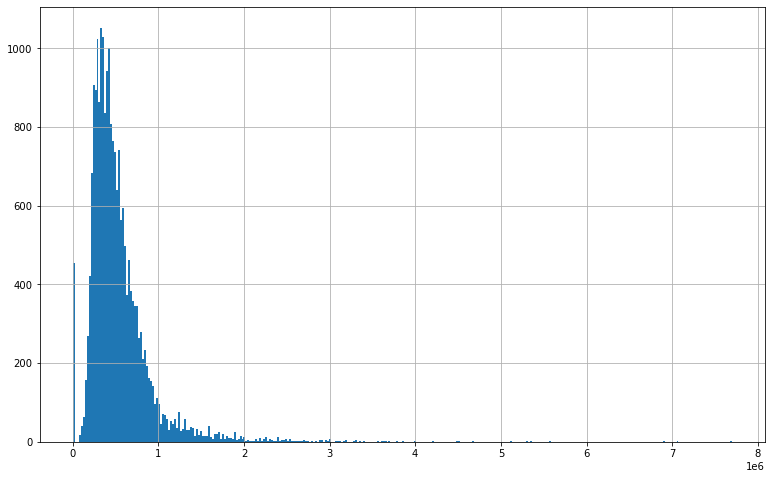

In [5]:
# Checking the distribution of my dependent variable.
df['price'].hist(bins='auto', figsize=(13,8))

A sizeable number of observations with price=0. These are useless to me. Remove them, as well as the features 'id', 'lat', and 'long'. (I intend to use zipcode data instead.)

In [6]:
purged = df.drop(df[df.price == 0].index, axis=0)
X = purged.drop(['id', 'price', 'lat', 'long'], axis=1)
y = purged['price']

<AxesSubplot:>

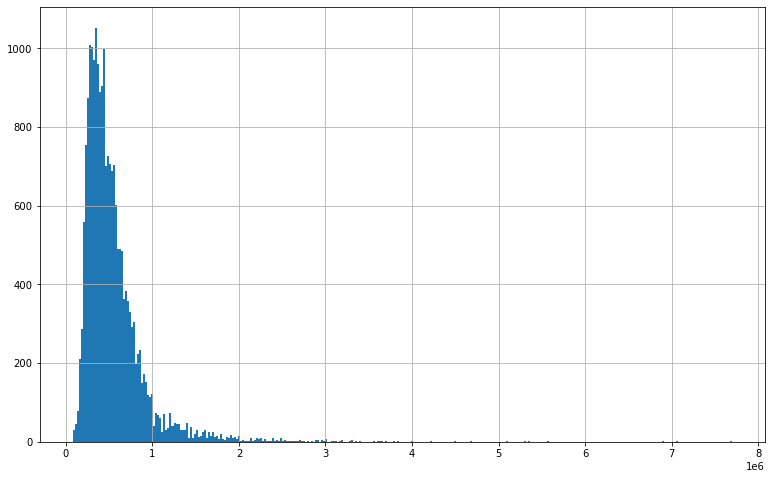

In [7]:
y.hist(bins='auto', figsize=(13,8))

In [8]:
# How many observations are we left with?
len(y)

21143

In [9]:
categorical = ['bathrooms', 'bedrooms', 'condition', 'floors', 'view', 'yr_built', 'yr_renovated', 'zipcode', 'grade', 'waterfront']
continuous = ['sqft_basement', 'sqft_above', 'sqft_living', 'sqft_lot', 'sqft_living15', 'sqft_lot15']

In [10]:
# Baseline model is here. For the sake of speed, I completely ignored categorical variables.
linreg = LinearRegression()
linreg.fit(X[continuous], y)
mse = make_scorer(mean_squared_error)
baseline = cross_val_score(linreg, X[continuous], np.log(y), cv=10, scoring=mse)
np.sqrt(baseline.mean())

0.37007649816973703

### Phase 2: Feature manipulation and engineering.

In [11]:
# A bit of feature engineering:

# Rather than using year renovated, create a new feature, that equals 1 if the house was renovated, 0 if not.
X['renovated'] = (X['yr_renovated'] > 0).astype('int')

# New feature, 'basement', equals 1 if the house has a basement, 0 if not.
X['basement'] = (X['sqft_basement'] > 0).astype('int')

# Pull the day, month, and year a property was sold into their own features.
X['date'] = pd.to_datetime(X['date'])
X['month_sold'] = X['date'].dt.month
X['yr_sold'] = X['date'].dt.year
X['day_sold'] = X['date'].dt.day
X = X.drop(['yr_renovated', 'sqft_basement', 'date'], axis=1)

# Update lists with new features.
categorical.remove('yr_renovated')
categorical += ['renovated', 'basement', 'month_sold', 'yr_sold', 'day_sold']
continuous.remove('sqft_basement')

In [12]:
# Checking for collinearity.
X.corr()[(abs(X.corr())>.75)]

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,yr_built,zipcode,sqft_living15,sqft_lot15,renovated,basement,month_sold,yr_sold,day_sold
bedrooms,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
bathrooms,NaN,1.000000,0.755278,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
sqft_living,NaN,0.755278,1.000000,NaN,NaN,NaN,NaN,NaN,0.763101,0.876678,NaN,NaN,0.756389,NaN,NaN,NaN,NaN,NaN,NaN
sqft_lot,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
floors,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
waterfront,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
view,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
condition,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
grade,NaN,NaN,0.763101,NaN,NaN,NaN,NaN,NaN,1.000000,0.756382,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
sqft_above,NaN,NaN,0.876678,NaN,NaN,NaN,NaN,NaN,0.756382,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [13]:
# 'sqft_above' and 'yr_sold' appear to be the biggest offenders, so I remove them.
# I think their info is encoded elsewhere anyway.
X.drop('sqft_above', axis=1, inplace=True)
X.drop('yr_sold', axis=1, inplace=True)
categorical.remove('yr_sold')
continuous.remove('sqft_above')

In [14]:
# One-hot encode my categorical variables.
needs_one_hot = categorical.copy()
# These two are already one-hot encoded.
needs_one_hot.remove('renovated')
needs_one_hot.remove('basement')
one_hot = []
for cat in needs_one_hot:
    one_hot.append(pd.get_dummies(X[cat], prefix=cat, drop_first=True))
    
X_oh = X.join(pd.concat(one_hot, axis=1))
X_oh.drop(needs_one_hot, axis=1, inplace=True)
X_oh.head()

,sqft_living,sqft_lot,sqft_living15,sqft_lot15,renovated,basement,bathrooms_0.75,bathrooms_1.0,bathrooms_1.25,bathrooms_1.5,...,day_sold_22,day_sold_23,day_sold_24,day_sold_25,day_sold_26,day_sold_27,day_sold_28,day_sold_29,day_sold_30,day_sold_31
0,1180,5650,1340,5650,0,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
1,2570,7242,1690,7639,1,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,770,10000,2720,8062,0,0,0,1,0,0,...,0,0,0,1,0,0,0,0,0,0
3,1960,5000,1360,5000,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,1680,8080,1800,7503,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


**Does inclusion of all categorical variables improve model accuracy? Yes.**

In [15]:
linreg = LinearRegression()
linreg.fit(X_oh, y)
cv_10 = cross_val_score(linreg, X_oh, np.log(y), cv=10, scoring=mse)
np.sqrt(cv_10.mean())

0.1821659875542598

<AxesSubplot:xlabel='sqft_lot', ylabel='price'>

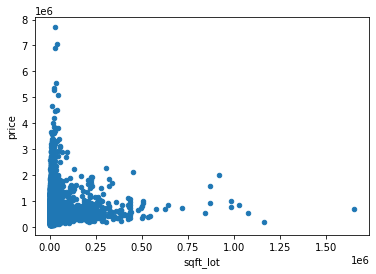

In [16]:
# 'sqft_lot' and 'sqft_lot15' appear to be the biggest offenders.
pd.concat([(X_oh['sqft_lot']), y], axis=1).plot.scatter('sqft_lot', 'price')

In [17]:
# Curious about R-squared. It's actually quite high right now.

parse = ['C({})'.format(cat) for cat in categorical]
parse = '+'.join(parse)
formula = 'price ~ ' + '+'.join(continuous) + '+' + parse
model = smf.ols(formula=formula, data=(X.join(np.log(y)))).fit()
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  price   R-squared:                       0.886
Model:                            OLS   Adj. R-squared:                  0.884
Method:                 Least Squares   F-statistic:                     551.2
Date:                Sat, 05 Dec 2020   Prob (F-statistic):               0.00
Time:                        15:30:07   Log-Likelihood:                 6514.8
No. Observations:               21143   AIC:                        -1.244e+04
Df Residuals:                   20848   BIC:                        -1.009e+04
Df Model:                         294                                         
Covariance Type:            nonrobust                                         
========================================================================================
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
Intercept               11.5851      0.214     54.171      0.000      11.166      12.004
C(bathrooms)[T.0.75]     0.3141      0.107      2.949      0.003       0.105       0.523
C(bathrooms)[T.1.0]      0.3156      0.104      3.027      0.002       0.111       0.520
C(bathrooms)[T.1.25]     0.3150      0.120      2.618      0.009       0.079       0.551
C(bathrooms)[T.1.5]      0.3407      0.104      3.263      0.001       0.136       0.545
C(bathrooms)[T.1.75]     0.3671      0.104      3.518      0.000       0.163       0.572
C(bathrooms)[T.2.0]      0.3622      0.104      3.470      0.001       0.158       0.567
C(bathrooms)[T.2.25]     0.3978      0.104      3.809      0.000       0.193       0.603
C(bathrooms)[T.2.5]      0.3962      0.104      3.793      0.000       0.191       0.601
C(bathrooms)[T.2.75]     0.4005      0.105      3.831      0.000       0.196       0.605
C(bathrooms)[T.3.0]      0.4048      0.105      3.869      0.000       0.200       0.610
C(bathrooms)[T.3.25]     0.4178      0.105      3.989      0.000       0.212       0.623
C(bathrooms)[T.3.5]      0.4096      0.105      3.911      0.000       0.204       0.615
C(bathrooms)[T.3.75]     0.4364      0.106      4.134      0.000       0.229       0.643
C(bathrooms)[T.4.0]      0.3996      0.106      3.779      0.000       0.192       0.607
C(bathrooms)[T.4.25]     0.4235      0.107      3.972      0.000       0.215       0.632
C(bathrooms)[T.4.5]      0.3876      0.106      3.647      0.000       0.179       0.596
C(bathrooms)[T.4.75]     0.4312      0.111      3.871      0.000       0.213       0.650
C(bathrooms)[T.5.0]      0.3916      0.113      3.474      0.001       0.171       0.612
C(bathrooms)[T.5.25]     0.4127      0.116      3.544      0.000       0.184       0.641
C(bathrooms)[T.5.5]      0.2827      0.122      2.320      0.020       0.044       0.521
C(bathrooms)[T.5.75]     0.1242      0.140      0.888      0.375      -0.150       0.398
C(bathrooms)[T.6.0]      0.3970      0.129      3.066      0.002       0.143       0.651
C(bathrooms)[T.6.25]     0.3181      0.168      1.897      0.058      -0.011       0.647
C(bathrooms)[T.6.5]      0.4149      0.166      2.505      0.012       0.090       0.740
C(bathrooms)[T.6.75]    -0.2678      0.167     -1.606      0.108      -0.595       0.059
C(bathrooms)[T.7.5]      0.0457      0.224      0.204      0.838      -0.393       0.485
C(bathrooms)[T.7.75]    -0.1248      0.218     -0.573      0.567      -0.552       0.302
C(bathrooms)[T.8.0]     -0.6035      0.171     -3.537      0.000      -0.938      -0.269
C(bedrooms)[T.2]         0.0310      0.014      2.194      0.028       0.003       0.059
C(bedrooms)[T.3]         0.0580      0.014      4.092      0.000       0.030       0.086
C(bedrooms)[T.4]         0.0589      0.014      4.064    

One last check for collinearity. 'sqft_living' is still showing some collinearity with 'bathrooms', 'grade' and 'sqft_living15', but they're quite close to my (arbitrarily) chosen cutoff of abs(.75), so I decide to keep them. I feel the information in each is unique.

In [18]:
X.corr()[abs(X.corr()) > .75]

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,yr_built,zipcode,sqft_living15,sqft_lot15,renovated,basement,month_sold,day_sold
bedrooms,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
bathrooms,NaN,1.000000,0.755278,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
sqft_living,NaN,0.755278,1.000000,NaN,NaN,NaN,NaN,NaN,0.763101,NaN,NaN,0.756389,NaN,NaN,NaN,NaN,NaN
sqft_lot,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
floors,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
waterfront,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
view,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
condition,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
grade,NaN,NaN,0.763101,NaN,NaN,NaN,NaN,NaN,1.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
yr_built,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN


array([[<AxesSubplot:title={'center':'sqft_living'}>,
        <AxesSubplot:title={'center':'sqft_lot'}>],
       [<AxesSubplot:title={'center':'sqft_living15'}>,
        <AxesSubplot:title={'center':'sqft_lot15'}>]], dtype=object)

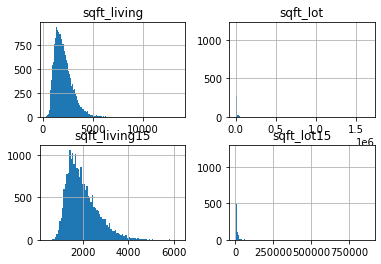

In [19]:
X_oh[continuous].hist(bins='auto')

In [20]:
# A set of min-max normalized dependent variables.
preprocessed = X_oh.copy()
for cont in continuous:
    preprocessed[cont] = (preprocessed[cont]-preprocessed[cont].min()) / (preprocessed[cont].max()-preprocessed[cont].min())
#     preprocessed[cont] = (preprocessed[cont]-preprocessed[cont].mean()) / preprocessed[cont].std()

**Concern: not a normal distribution for residuals.**

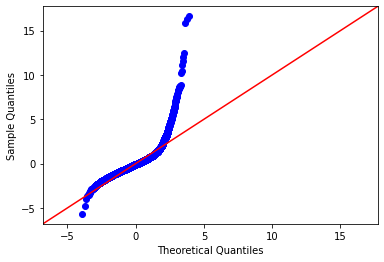

In [21]:
formula = 'price ~ sqft_living'
model = smf.ols(formula=formula, data=X_oh.join(y)).fit()
resid = model.resid
fig = sm.graphics.qqplot(resid, dist=stats.norm, line='45', fit=True)

The same plot, but fitting for the natural log of my dependent variable. Looks much closer to normal. One noticeable outlier at the bottom there.

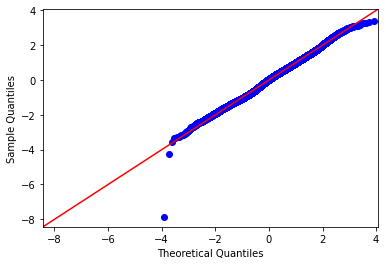

In [22]:
formula = 'price ~ sqft_living'
model = smf.ols(formula=formula, data=X_oh.join(np.log(y))).fit()
resid = model.resid
fig = sm.graphics.qqplot(resid, dist=stats.norm, line='45', fit=True)

**No noticeable signs of heteroscedasticity** after log transorm. One noticeable outlier.

<AxesSubplot:>

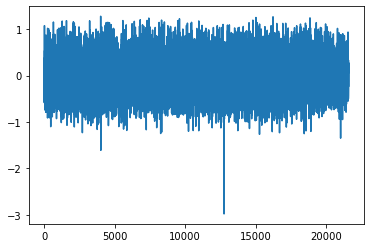

In [23]:
model.resid.plot()

Does the distribution of my dependent variable appear more normal with a **log transform**? Yes.

<AxesSubplot:>

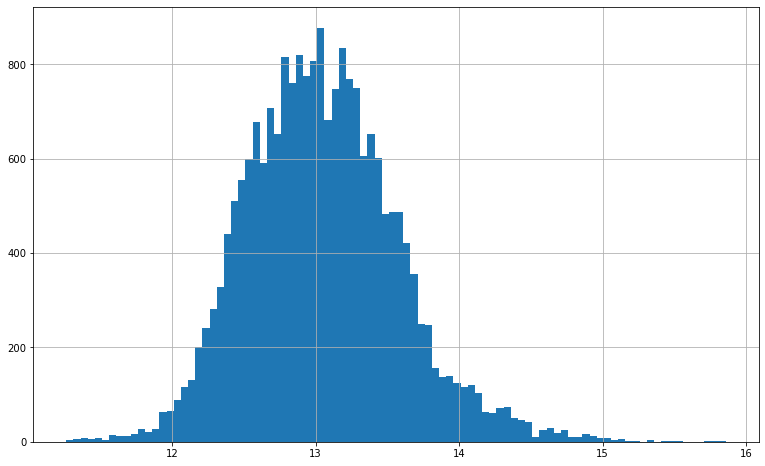

In [24]:
np.log(y).hist(bins='auto', figsize=(13,8))

In [25]:
linreg = LinearRegression()
cv_10 = cross_val_score(linreg, preprocessed, np.log(y), cv=10, scoring=mse)
baseline = np.sqrt(cv_10.mean())
baseline

18932815238.545578

Considering that residuals are measuring a log transformed response, This baseline RMSE obtained via cross validation is quite massive. I couldn't find what made it so large, but I suspect something is amiss with this particular estimate.

Alternatively, normalizing dependent variables could have removed some biases, and this RMSE is a more accurate reflection of the model than earlier (better) RMSE scores.

### Phase 3: Feature reduction/shrinkage

**First attempt at narrowing down features using recursive feature elimination (RFE)**. I played around with the number of features to select to find a sweet spot of few features, but a still pretty good RMSE, settling on 50 features.

In [26]:
linreg = LinearRegression()
selector = RFE(linreg, n_features_to_select=50)
selector = selector.fit(preprocessed, np.log(y))

In [27]:
preprocessed.columns[selector.support_]

Index(['sqft_living', 'sqft_lot', 'sqft_living15', 'bathrooms_2.75',
       'bathrooms_3.25', 'bathrooms_3.5', 'bathrooms_3.75', 'bathrooms_6.75',
       'bathrooms_7.75', 'bathrooms_8.0', 'bedrooms_10', 'view_4.0',
       'zipcode_98004', 'zipcode_98005', 'zipcode_98006', 'zipcode_98007',
       'zipcode_98008', 'zipcode_98027', 'zipcode_98029', 'zipcode_98033',
       'zipcode_98034', 'zipcode_98039', 'zipcode_98040', 'zipcode_98052',
       'zipcode_98053', 'zipcode_98072', 'zipcode_98074', 'zipcode_98075',
       'zipcode_98077', 'zipcode_98102', 'zipcode_98103', 'zipcode_98105',
       'zipcode_98107', 'zipcode_98109', 'zipcode_98112', 'zipcode_98115',
       'zipcode_98116', 'zipcode_98117', 'zipcode_98118', 'zipcode_98119',
       'zipcode_98122', 'zipcode_98125', 'zipcode_98126', 'zipcode_98133',
       'zipcode_98136', 'zipcode_98144', 'zipcode_98155', 'zipcode_98177',
       'zipcode_98199', 'waterfront_1.0'],
      dtype='object')

A hugely improved RMSE from the baseline. This is looking like a much better model both in terms of interpretability and accuracy.

In [28]:
linreg = LinearRegression()
cv_10 = cross_val_score(linreg, preprocessed[preprocessed.columns[selector.support_]], np.log(y), cv=10, scoring=mse)
baseline = np.sqrt(cv_10.mean())
baseline

0.22275369623923602

In [44]:
nfeats = np.arange(10, 291, 10)
RMSEs = []
for d in nfeats:
    print(d)
    selector = RFE(linreg, n_features_to_select=d)
    selector = selector.fit(preprocessed, np.log(y))
    linreg = LinearRegression()
    cv_3 = cross_val_score(linreg, preprocessed[preprocessed.columns[selector.support_]], np.log(y), cv=3, scoring=mse)
    RMSEs.append(np.sqrt(cv_3.mean()))

10
20
30
40
50
60
70
80
90
100
110
120
130
140
150
160
170
180
190
200
210
220
230
240
250
260
270
280
290


In [45]:
RMSEs

[0.34842932718609304,
 0.2981033448554975,
 0.2717419075425471,
 0.23664982366820825,
 0.22291310498585767,
 19417000135.225452,
 0.2182847533122855,
 0.20723941737416782,
 0.20226483887569344,
 17363876874.025467,
 37356650305.07773,
 49526674096.77382,
 35094246784.82609,
 39604775287.04669,
 11418764177.448286,
 21594445087.281586,
 63723057602.49911,
 15774971753.128569,
 24112488062.78955,
 35168935879.1966,
 4494567662.014164,
 9321442855.459494,
 22789371434.849335,
 38544453797.96017,
 4012824752.6553073,
 31228414328.531,
 6675749375.869261,
 9129616892.470661,
 20070772876.131973]

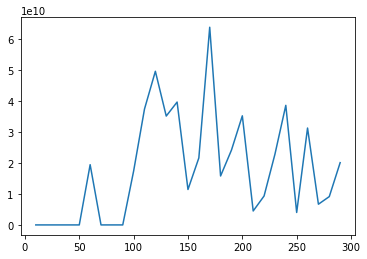

In [46]:
plt.plot(nfeats, RMSEs)

**Second attempt at feature reduction, this time using best subset selection**. BUT best subset selection is **computationally unfeasible** for such a large number of features (*Introduction to Statistical Learning*, p.207).

In [29]:
# from itertools import combinations

# options = []
# for k in range(len(X_oh.columns)):
#     print(k+1)
#     feature_selections = list(combinations(X_oh.columns, k+1))
#     print(len(feature_selections))
#     best = []
#     bestmse = 100000000
#     for s in feature_selections:
#         linreg = LinearRegression()
#         linreg.fit(X_oh[list(s)], np.log(y))
#         yhats = linreg.predict(X_oh[list(s)])
#         mse = mean_squared_error(np.log(y), yhats)
#         if mse < bestmse:
#             best = list(s)
#             bestmse = mse
            
#     options.append(best)        

**Third attempt: the Lasso.** Alpha, more commonly denoted lambda in other sources, was played with until a desireably few number of features were picked while retaining a low RMSE.

In [30]:
lasso = Lasso(alpha=0.0001, normalize=True, copy_X=True)
lasso.fit(X_oh, np.log(y))
concise = pd.DataFrame([X_oh.columns[lasso.coef_ != 0], lasso.coef_[lasso.coef_ != 0]]).transpose()
concise.columns = ['feature', 'coefficient']

In [31]:
linreg = LinearRegression()
cv_10 = cross_val_score(linreg, X_oh[X_oh.columns[lasso.coef_ != 0]], np.log(y), cv=10, scoring=mse)
np.sqrt(cv_10.mean())

0.19988376189988827

An excellent RMSE, a pretty narrow selection of features. Slightly different from the selection RFE chose. This model chose several instances of 'view' rather than 'bathroom', as was the case with RFE.

Going back to RFE and changing the number of features to 69 to make it compete with the Lasso, the Lasso returned a better cross validated MRSE, so I've kept the Lasso's features moving forward.

### Visualization of zipcode data obtained from the Lasso.

In [32]:
# load a list of all zipcodes in King County.
zips_in_king = pd.read_csv('data/zipcodes.csv')
zips_in_king['ZIP'] = zips_in_king['ZIP'].astype('str')
zips_in_king.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 204 entries, 0 to 203
Data columns (total 7 columns):
OBJECTID        204 non-null int64
ZIP             204 non-null object
ZIPCODE         204 non-null int64
COUNTY          203 non-null float64
ZIP_TYPE        204 non-null object
Shape_Length    204 non-null float64
Shape_Area      204 non-null float64
dtypes: float64(3), int64(2), object(2)
memory usage: 11.3+ KB


In [33]:
# My zipcode and coefficient data obtained from the Lasso.
zips = concise.feature.iloc[12:58]
coeffs = concise.coefficient.iloc[12:58]
zips = zips.str.replace('zipcode_', '')
zipcode_coeffs = pd.DataFrame([zips, coeffs]).transpose()
zipcode_coeffs.columns = ['zip', 'coeff']

# If that zipcode has a positive impact on price, mark it 1.
# If negative, 0.
zipcode_coeffs['pos'] = zipcode_coeffs['coeff'] > 0
zipcode_coeffs.head()

,zip,coeff,pos
12,98002,-0.314816,False
13,98003,-0.311501,False
14,98004,0.521011,True
15,98005,0.108034,True
16,98006,0.0672796,True


In [34]:
import folium
map = folium.Map(location=[47.5287, -121.8254], default_zoom_start=15)
folium.Choropleth(
    geo_data=r'data/wa_washington_zip_codes_geo.min.json', 
    data=zipcode_coeffs,
    columns=['zip', 'pos'],
    key_on='feature.properties.ZCTA5CE10',
    fill_color='PuBuGn',
    fill_opacity=0.5,
    line_opacity=0.2,
    legend='Coefficient'
).add_to(map)
map

/Users/stlanier/opt/anaconda3/envs/learn-env/lib/python3.6/site-packages/numpy/lib/histograms.py:778: RuntimeWarning: Converting input from bool to <class 'numpy.uint8'> for compatibility.
  a, weights = _ravel_and_check_weights(a, weights)


### Future Work:

Aim for predictive power. Work for incorporating a term for interactions is below.

In [35]:
# from itertools import combinations

# interactions = []

# feat_combinations = combinations(preprocessed.columns[selector.support_], 2)

# data = preprocessed.copy()
# for i, (a, b) in enumerate(feat_combinations):
#     data['interaction'] = data[a] * data[b]
#     score = np.mean(cross_val_score(linreg, data, y, scoring=mse, cv=10))
#     if score < baseline:
#         interactions.append((a, b, round(score,3)))
#         print(a, b)
    
#     if i % 50 == 0:
#         print(i)
            
# print('Top 3 interactions: %s' %sorted(interactions, key=lambda inter: inter[2], reverse=True)[:3])

In [36]:
# len(list(feat_combinations))

## Conclusion

Ultimately, the Lasso was chosen as the best method for this data to reduce number of features while retaining accuracy. Using the features it chose produced a **cross validated RMSE of 0.19**, a huge improvement from the baseline model (0.37). I performed these steps to produce the model:

1. Removed observation that don't have price data, leaving me with ~21,000 observations and baseline cross validated RMSE of 0.37.


2. Engineered some features. Originally, the year a house was renovated and the square footage of the basement were included. I turned this into binary, categorical variables: had a house been renovated? Was there a basement? I also created separate features for day sold, month sold, and year sold.


3. Pruned a few collinear features('sqft_above', 'yr_sold').


4. One-hot encoded categorical variables and min-max normalized continuous variables. (RMSE 0.18)


5. log-transformed my dependent variable, price. This created a more normal distribution without any heteroscedasticity. (RMSE 0.18)


6. Lastly, I tried Recursive Feature Elimination (RMSE 0.22) and The Lasso (RMSE 0.19). Ultimately, I preferred the Lasso as it had a better cross validated RMSE and the features it selected made more sense, intuitively, in understanding a home's value than did RFE's features.

**Features that were found to have a positive effect on house price included: presence of a basement, a past renovation, a grade of 9 or higher, a waterfront location, and a number of zipcodes in the Seattle-Bellevue-Redmond area.**

**Features that were found to have a negative effect on house price included: a grade of 7 or lower and a number of zipcodes south of Seattle.**

Scaling features included the square footage of the house, and the average square footage of the 15 nearest properties.